colab: https://colab.research.google.com/drive/1j1ZMnuytovtVFwLb1udn8pF293T6giwh?usp=sharing

In [28]:
import numpy as np
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn.functional as F
import time

## Task1:

In [29]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 10

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                          shuffle=True, num_workers=2)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size,
                                         shuffle=False, num_workers=2)

classes = ('plane', 'car', 'bird', 'cat',
           'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

Files already downloaded and verified
Files already downloaded and verified


In [30]:
# set seed
SEED = 1727114
np.random.seed(SEED)
torch.manual_seed(SEED)

this neural network architecture consists only of convolutional layers and fully-connected (dense) layers. Specifically, there are 4 convolutional layers (conv1, conv2, conv3, and conv4) and 3 fully-connected layers (fc1, fc2, and fc3). Additionally, there is a max-pooling layer (pool) used after the first two convolutional layers. The activation function used in this network is ReLU (rectified linear unit).

In [31]:
class Net(nn.Module):
   
    '''
    defines a custom CNN architecture and initializes it for use in a neural network model.
    
    conv1: A convolutional layer with 3 input channels, 64 output channels, and a 3x3 kernel size.
    conv2: A convolutional layer with 64 input channels, 128 output channels, and a 3x3 kernel size.
    conv3: A convolutional layer with 128 input channels, 256 output channels, and a 3x3 kernel size.
    conv4: A convolutional layer with 256 input channels, 256 output channels, and a 3x3 kernel size.
    pool: A max-pooling layer with a 2x2 kernel size and a stride of 2.
    fc1: A fully-connected layer with 1024 input features and 120 output features.
    fc2: A fully-connected layer with 120 input features and 84 output features.
    fc3: A fully-connected layer with 84 input features and 10 output features (corresponding to the 10 classes)
    '''
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(1024, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    # here we define the forward pass, i.e. how our input x is modified as it moves through the network
    def forward(self, x):
        # Apply the first convolutional layer (conv1) followed by a ReLU activation and the max-pooling layer (pool)
        x = self.pool(F.relu(self.conv1(x))) 
        # Apply the second convolutional layer (conv2) followed by a ReLU activation and the max-pooling layer (pool).
        x = self.pool(F.relu(self.conv2(x)))
        # Apply the third convolutional layer (conv3) followed by a ReLU activation. 
        x = F.relu(self.conv3(x))
        # Apply the fourth convolutional layer (conv4) followed by a ReLU activation.
        x = F.relu(self.conv4(x))
        # Flatten the tensor to prepare it for the fully connected layers.
        x = torch.flatten(x, 1)
        # Apply the first fully connected layer (fc1) followed by a ReLU activation.
        x = F.relu(self.fc1(x))
        # Apply the second fully connected layer (fc2) followed by a ReLU activation.
        x = F.relu(self.fc2(x))
        # Apply the third fully connected layer (fc3) to produce the final output.
        x = self.fc3(x)
        return x
 
net = Net()

Define a loss function and optimiser

In [32]:
def train_epoch(trainloader, net, optimizer, criterion=nn.CrossEntropyLoss()):

    '''
    trains my CNN neural network for one epoch on the provided training dataset
    trainloader: A DataLoader object containing the training dataset.
    net: The CNN model you want to train.
    optimizer: The optimizer used for updating the model's parameters.
    criterion: The loss function used to compute the difference between predicted and true labels. It defaults to CrossEntropyLoss.
    '''

    ntrain = 0
    correct = 0
    total_loss = 0
    
    for i, data in enumerate(trainloader, 0):
        net.train()
        # get the inputs; data is a list of [inputs, labels]
        images, labels = data
        # zero the parameter gradients
        optimizer.zero_grad()
        # Compute the output for all the images in the batch_size; remember we set a batch_size of 4 in the beginning!
        outputs = net(images)
        # Compute the loss value
        loss = criterion(outputs, labels)
        # Compute the gradients
        loss.backward()
        # Take the optimisation step
        optimizer.step()

        # print statistics
        total_loss += loss.item()

        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        # compute the total number of images processed by adding the number of images in each batch
        ntrain += labels.size(0) 
        correct += (predicted == labels).sum().item()

    # calculate the mean loss and the accuracy for the entire training dataset.
    mean_loss = total_loss/ntrain
    accuracy = correct / ntrain

    return mean_loss, accuracy

In [33]:
def test_epoch(testloader, net, criterion=nn.CrossEntropyLoss()):

    correct = 0
    ntest = 0
    total_loss = 0
    net.eval()

    # since we're not training, we don't need to calculate the gradients for our outputs; therefore there
    # is no need to store the computational graph in between
    with torch.no_grad():
        for data in testloader: #iterate over all the test images
            images, labels = data
            # calculate outputs by running images through the network
            outputs = net(images)
            loss_test = criterion(outputs, labels)
            total_loss += loss_test.item()

            # the class with the highest energy is what we choose as prediction
            _, predicted = torch.max(outputs.data, 1)
            # compute the total number of images processed by adding the number of images in each batch
            ntest += labels.size(0) 
            correct += (predicted == labels).sum().item()

    # calculate the mean loss and the accuracy for the test dataset.
    mean_loss_test = total_loss /ntest
    accuracy =  correct / ntest
    return mean_loss_test, accuracy

In [45]:
def nepoch(nepochs, trainloader, testloader, net, optimizer, criterion, check=False):

    '''
    create a for loop that runs over the number of epochs and computes for each epoch the train and test outputs
    Arguments:
        nepochs: the number of epochs
        trainloader, testloader: dataloader
        net: A NN model
        optimizer: optim.SGD, The optimisation algorithm used for the backpropagation.
        criterion: The loss function used to train the model.
    return: the mean train and test loss, the test error
    '''
    
    train_loss = [] # train loss list
    test_loss = [] # test loss list
    train_acc_list = [] # train accuracy list
    test_acc_list = [] # test accuracy list
    # for loop that runs over the number of epochs
    for epoch in range(nepochs):
        mean_loss_train, acc_train = train_epoch(trainloader, net, optimizer, criterion)
        train_loss.append(mean_loss_train)
        train_acc_list.append(acc_train)

        mean_loss_test, acc_test = test_epoch(testloader, net, criterion)
        test_loss.append(mean_loss_test)
        test_acc_list.append(acc_test)

        print(f'Epoch: {epoch:03} | Train Loss: {mean_loss_train:.04} |Test Loss: {mean_loss_test:.04} | Train accuracy: {acc_train:.04} | Test accuracy: {acc_test:.04}')
        if check==True and epoch>=2:
            if np.linalg.norm(train_loss[-2]-train_loss[-1]) < 1e-3:
                print(f'model converges at {epoch}th iteration')
                break

        
    return train_loss, test_loss, train_acc_list, test_acc_list

In [35]:
def plot_losses_accuracies(train_losses, test_losses, train_accuracies, test_accuracies):
    epochs = range(1, len(train_losses) + 1)

    # Create a 1x2 grid of subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

    # Plot Losses on the first subplot
    ax1.plot(epochs, train_losses, marker='.', linestyle='-', label='Train Loss')
    ax1.plot(epochs, test_losses, marker='.', linestyle='--', label='Test Loss')
    ax1.set_xlabel('Epochs')
    ax1.set_ylabel('Loss')
    ax1.set_title('Training and Test Loss per Epoch')
    ax1.set_xticks(epochs)
    ax1.grid()
    ax1.legend()

    # Plot Accuracies on the second subplot
    ax2.plot(epochs, train_accuracies, marker='.', linestyle='-', label='Train Accuracy')
    ax2.plot(epochs, test_accuracies, marker='.', linestyle='--', label='Test Accuracy')
    ax2.set_xlabel('Epochs')
    ax2.set_ylabel('Accuracy')
    ax2.set_title('Training and Test Accuracy per Epoch')
    ax2.set_xticks(epochs)
    ax2.grid()
    ax2.legend()

In [36]:
# sets up the loss function and optimizer for training the model.
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.005, momentum=0.9)

In [37]:
n = 15
train_loss, test_loss, train_acc, test_acc = nepoch(n, trainloader, testloader, net, optimizer, criterion)

Epoch: 000 | Train Loss: 0.1717 |Test Loss: 0.1329 | Train accuracy: 0.3521 | Test accuracy: 0.5223
Epoch: 001 | Train Loss: 0.1142 |Test Loss: 0.1047 | Train accuracy: 0.5936 | Test accuracy: 0.6259
Epoch: 002 | Train Loss: 0.08864 |Test Loss: 0.08895 | Train accuracy: 0.6938 | Test accuracy: 0.6997
Epoch: 003 | Train Loss: 0.07191 |Test Loss: 0.08039 | Train accuracy: 0.7524 | Test accuracy: 0.7273
Epoch: 004 | Train Loss: 0.0589 |Test Loss: 0.08026 | Train accuracy: 0.7972 | Test accuracy: 0.7303
Epoch: 005 | Train Loss: 0.04878 |Test Loss: 0.08632 | Train accuracy: 0.832 | Test accuracy: 0.7378
Epoch: 006 | Train Loss: 0.03983 |Test Loss: 0.09534 | Train accuracy: 0.8625 | Test accuracy: 0.7142
Epoch: 007 | Train Loss: 0.03358 |Test Loss: 0.09238 | Train accuracy: 0.8837 | Test accuracy: 0.7459
Epoch: 008 | Train Loss: 0.02755 |Test Loss: 0.09218 | Train accuracy: 0.9065 | Test accuracy: 0.7517
Epoch: 009 | Train Loss: 0.02381 |Test Loss: 0.106 | Train accuracy: 0.918 | Test accura

## Plot training and test losses and accuracy for the original model

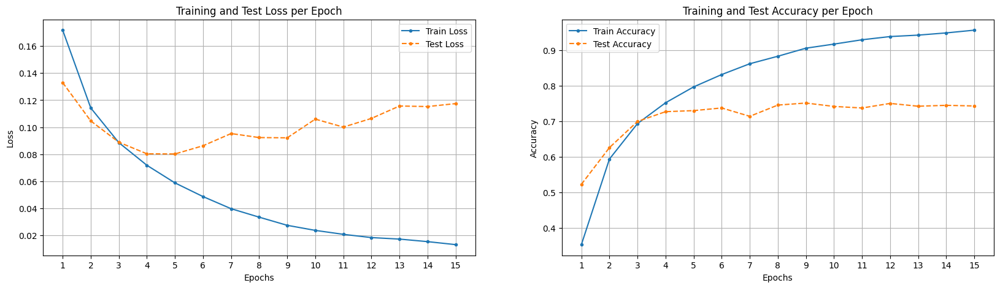

In [38]:
plot_losses_accuracies(train_loss, test_loss, train_acc, test_acc)

I got training loss, test loss, training accuracy, and test accuracy for each epoch. 

The training results are worse than test results in the beginning because at the start of training, the model's weights are randomly initialized. As a result, the model's performance is essentially random, and any differences between training and test results are due to chance.

As epoches number increases, the test loss starts increasing while the training loss continues to decrease after the 3rd epoch. This divergence between training and test loss indicates that the model is fitting the training data more and more closely, but is not generalizing well to the test data. In other words, the model is overfitting.

Simultaneously, the training accuracy keeps improving, which is expected as the model continues to learn from the training data. However, the test accuracy plateaus and does not improve much after the initial increase. This stagnation of test accuracy, combined with the increasing test loss and the gap between training and test accuracy, further confirms that the model is overfitting.

Good news is after 10 epoches, accuracy for test and train data are all above 60%.

## Task2:

Dropout is a regularization technique used in neural networks to prevent overfitting by introducing randomness and reducing the model's capacity during training, encouraging the model to learn more robust and generalized features. It helps improve the generalization performance of the model when dealing with test data. During training, dropout works by randomly "dropping out" or deactivating a fraction of neurons in a layer at each training iteration. The probability of a neuron being dropped out is a hyperparameter and is usually set to a value between 0.0 and 1.0, here I use 0.5.

When a neuron is dropped out, it does not contribute to the forward pass or the backward pass, effectively being removed from the network for that iteration. This random removal of neurons forces the model to learn more robust features and prevents the model from relying too heavily on individual neurons or co-adapting to other neurons. As a result, the model becomes more resilient and generalized.

During testing or evaluation, dropout is turned off, and all neurons are used. However, the output of each neuron is scaled down by the dropout rate to account for the fact that all neurons are active during testing, whereas only a fraction was active during training. This scaling ensures that the expected output during testing matches the average output during training.

By adding dropout during training, you effectively create a more robust model that is less sensitive to noise and specific patterns in the training data.

The location where I place the dropout layer matters and can influence the effectiveness of the dropout technique in preventing overfitting and improving generalization, which I compare later below.

The formula is:

Calculate the mean and variance for each feature in a mini-batch:

$\mu = \frac{1}{N} \sum_{i=1}^{N} x_i$
$\sigma^2 = \frac{1}{N} \sum_{i=1}^{N} (x_i - \mu)^2$
Normalize the input features using the calculated mean and variance:

$x_{i, normalized} = \frac{x_i - \mu}{\sqrt{\sigma^2 + \epsilon}}$
Scale and shift the normalized input features using learned parameters gamma (γ) and beta (β):

$y_i = \gamma x_{i, normalized} + \beta$
In this formula, $x_i$ is the input feature, $N$ is the number of elements in the mini-batch, and $\epsilon$ is a small constant added for numerical stability. The parameters $\gamma$ and $\beta$ are learned during training to allow the model to control the mean and variance of the outputs after normalization.

In [54]:
class Net_drop_fc(nn.Module):

    '''
    defines a custom CNN architecture with dropout in fully connected layers and initializes it for use in a neural network model.
    
    conv1: A convolutional layer with 3 input channels, 64 output channels, and a 3x3 kernel size.
    conv2: A convolutional layer with 64 input channels, 128 output channels, and a 3x3 kernel size.
    conv3: A convolutional layer with 128 input channels, 256 output channels, and a 3x3 kernel size.
    conv4: A convolutional layer with 256 input channels, 256 output channels, and a 3x3 kernel size.
    pool: A max-pooling layer with a 2x2 kernel size and a stride of 2.
    fc1: A fully-connected layer with 1024 input features and 120 output features.
    fc2: A fully-connected layer with 120 input features and 84 output features.
    fc3: A fully-connected layer with 84 input features and 10 output features (corresponding to the 10 classes)
    dropout1: A dropout layer with a dropout probability of 0.5, applied after the fc1 layer.
    dropout2: A dropout layer with a dropout probability of 0.5, applied after the fc2 layer.
    '''

    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        
        self.fc1 = nn.Linear(1024, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

        self.dropout1 = nn.Dropout(0.5) # Add dropout layer with 0.5 probability
        self.dropout2 = nn.Dropout(0.5) # Add dropout layer with 0.5 probability
        

    def forward(self, x):

        '''
        defines the forward pass of the neural network
        '''
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = self.dropout1(x) # Apply dropout after fc1
        x = F.relu(self.fc2(x))
        x = self.dropout2(x) # Apply dropout after fc2
        x = self.fc3(x)
        return x

    
class Net_drop_conv(nn.Module):

    '''
    defines a custom CNN architecture with dropout in convolutional layers and initializes it for use in a neural network model.
    
    conv1: A convolutional layer with 3 input channels, 64 output channels, and a 3x3 kernel size.
    conv2: A convolutional layer with 64 input channels, 128 output channels, and a 3x3 kernel size.
    conv3: A convolutional layer with 128 input channels, 256 output channels, and a 3x3 kernel size.
    conv4: A convolutional layer with 256 input channels, 256 output channels, and a 3x3 kernel size.
    pool: A max-pooling layer with a 2x2 kernel size and a stride of 2.
    fc1: A fully-connected layer with 1024 input features and 120 output features.
    fc2: A fully-connected layer with 120 input features and 84 output features.
    fc3: A fully-connected layer with 84 input features and 10 output features (corresponding to the 10 classes)
    dropout1: A dropout layer with a dropout probability of 0.5, applied after the conv1 layer.
    dropout2: A dropout layer with a dropout probability of 0.5, applied after the conv2 layer.
    dropout3: A dropout layer with a dropout probability of 0.5, applied after the conv3 layer.
    '''

    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(1024, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)
        self.dropout1 = nn.Dropout(0.5) # Add dropout layer with 0.5 probability
        self.dropout2 = nn.Dropout(0.5) # Add dropout layer with 0.5 probability
        self.dropout3 = nn.Dropout(0.5) # Add dropout layer with 0.5 probability
        

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.dropout1(x) # Apply dropout after conv1
        x = self.pool(F.relu(self.conv2(x)))
        x = self.dropout2(x) # Apply dropout after conv2
        x = F.relu(self.conv3(x))
        x = self.dropout3(x) # Apply dropout after conv3
        x = F.relu(self.conv4(x))

        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        
        return x


net_drop_fc = Net_drop_fc()
net_drop_conv = Net_drop_conv()

In [55]:
# sets up the loss function and optimizers for net_drop_fc model and net_drop_conv model
criterion = nn.CrossEntropyLoss()
optimizer_drop_fc = optim.SGD(net_drop_fc.parameters(), lr=0.005, momentum=0.9)
optimizer_drop_conv = optim.SGD(net_drop_conv.parameters(), lr=0.005, momentum=0.9)

In [57]:
n = 15
train_loss_fc, test_loss_fc, train_acc_fc, test_acc_fc = nepoch(n, trainloader, testloader, net_drop_fc, optimizer_drop_fc,criterion)
train_loss_conv, test_loss_conv, train_acc_conv, test_acc_conv= nepoch(n, trainloader, testloader, net_drop_conv, optimizer_drop_conv,criterion)

Epoch: 000 | Train Loss: 0.1911 |Test Loss: 0.1481 | Train accuracy: 0.2594 | Test accuracy: 0.4381
Epoch: 001 | Train Loss: 0.1446 |Test Loss: 0.1233 | Train accuracy: 0.4808 | Test accuracy: 0.5775
Epoch: 002 | Train Loss: 0.119 |Test Loss: 0.11 | Train accuracy: 0.5965 | Test accuracy: 0.6157
Epoch: 003 | Train Loss: 0.1036 |Test Loss: 0.09408 | Train accuracy: 0.653 | Test accuracy: 0.683
Epoch: 004 | Train Loss: 0.09319 |Test Loss: 0.09484 | Train accuracy: 0.695 | Test accuracy: 0.6801
Epoch: 005 | Train Loss: 0.08548 |Test Loss: 0.104 | Train accuracy: 0.7272 | Test accuracy: 0.6577
Epoch: 006 | Train Loss: 0.08006 |Test Loss: 0.08507 | Train accuracy: 0.7427 | Test accuracy: 0.7277
Epoch: 007 | Train Loss: 0.0759 |Test Loss: 0.08548 | Train accuracy: 0.76 | Test accuracy: 0.7281
Epoch: 008 | Train Loss: 0.07228 |Test Loss: 0.08979 | Train accuracy: 0.7758 | Test accuracy: 0.7271
Epoch: 009 | Train Loss: 0.06977 |Test Loss: 0.0901 | Train accuracy: 0.7838 | Test accuracy: 0.7176

## Plot training and test losses and accuracy after dropout

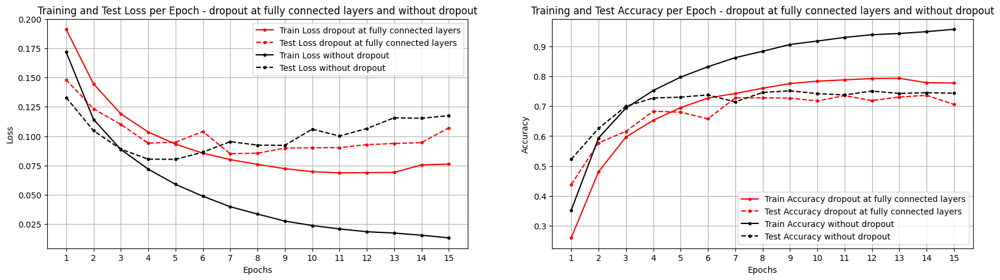

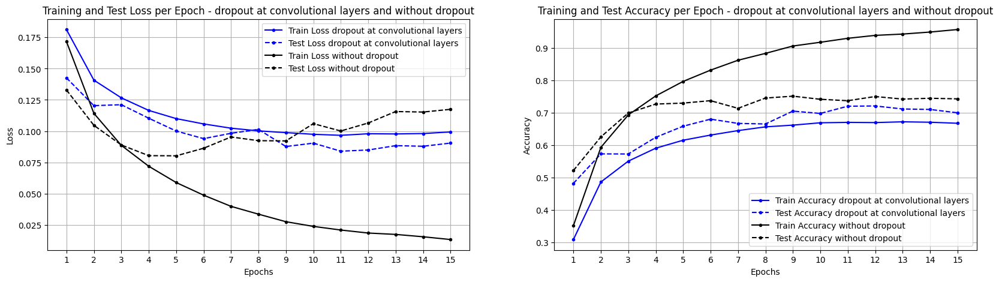

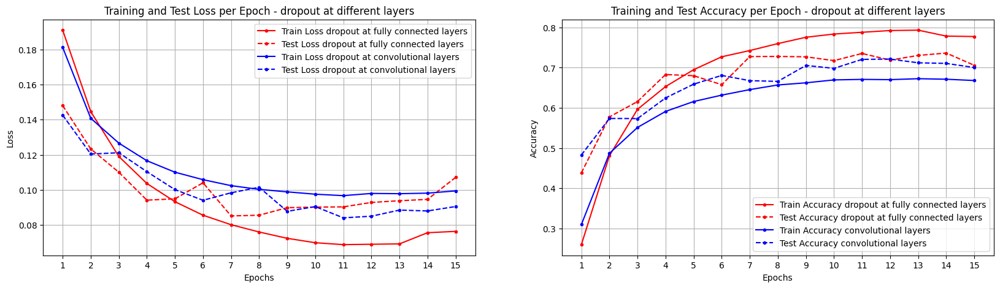

In [58]:
epochs = range(1, len(train_loss_fc) + 1)

# Create a 1x2 grid of subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

# Plot Losses on the first subplot
ax1.plot(epochs, train_loss_fc, color = 'r', marker='.', linestyle='-', label='Train Loss dropout at fully connected layers')
ax1.plot(epochs, test_loss_fc, color = 'r', marker='.', linestyle='--', label='Test Loss dropout at fully connected layers')
ax1.plot(epochs, train_loss, color = 'black', marker='.', linestyle='-', label='Train Loss without dropout')
ax1.plot(epochs, test_loss, color = 'black', marker='.', linestyle='--', label='Test Loss without dropout')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.set_title('Training and Test Loss per Epoch - dropout at fully connected layers and without dropout')
ax1.set_xticks(epochs)
ax1.grid()
ax1.legend()

# Plot Accuracies on the second subplot
ax2.plot(epochs, train_acc_fc, color = 'r', marker='.', linestyle='-', label='Train Accuracy dropout at fully connected layers')
ax2.plot(epochs, test_acc_fc, color = 'r', marker='.', linestyle='--', label='Test Accuracy dropout at fully connected layers')
ax2.plot(epochs, train_acc, color = 'black', marker='.', linestyle='-', label='Train Accuracy without dropout')
ax2.plot(epochs, test_acc, color = 'black', marker='.', linestyle='--', label='Test Accuracy without dropout')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.set_title('Training and Test Accuracy per Epoch - dropout at fully connected layers and without dropout')
ax2.set_xticks(epochs)
ax2.grid()
ax2.legend()

plt.show()

epochs = range(1, len(train_loss_fc) + 1)

# Create a 1x2 grid of subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

# Plot Losses on the first subplot
ax1.plot(epochs, train_loss_conv, color = 'blue', marker='.', linestyle='-', label='Train Loss dropout at convolutional layers')
ax1.plot(epochs, test_loss_conv, color = 'blue', marker='.', linestyle='--', label='Test Loss dropout at convolutional layers')
ax1.plot(epochs, train_loss, color = 'black', marker='.', linestyle='-', label='Train Loss without dropout')
ax1.plot(epochs, test_loss, color = 'black', marker='.', linestyle='--', label='Test Loss without dropout')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.set_title('Training and Test Loss per Epoch - dropout at convolutional layers and without dropout')
ax1.set_xticks(epochs)
ax1.grid()
ax1.legend()

# Plot Accuracies on the second subplot
ax2.plot(epochs, train_acc_conv, color = 'blue', marker='.', linestyle='-', label='Train Accuracy dropout at convolutional layers')
ax2.plot(epochs, test_acc_conv, color = 'blue', marker='.', linestyle='--', label='Test Accuracy dropout at convolutional layers')
ax2.plot(epochs, train_acc, color = 'black', marker='.', linestyle='-', label='Train Accuracy without dropout')
ax2.plot(epochs, test_acc, color = 'black', marker='.', linestyle='--', label='Test Accuracy without dropout')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.set_title('Training and Test Accuracy per Epoch - dropout at convolutional layers and without dropout')
ax2.set_xticks(epochs)
ax2.grid()
ax2.legend()

plt.show()

# Create a 1x2 grid of subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

# Plot Losses on the first subplot
ax1.plot(epochs, train_loss_fc, color = 'r', marker='.', linestyle='-', label='Train Loss dropout at fully connected layers')
ax1.plot(epochs, test_loss_fc, color = 'r', marker='.', linestyle='--', label='Test Loss dropout at fully connected layers')
ax1.plot(epochs, train_loss_conv, color = 'blue', marker='.', linestyle='-', label='Train Loss dropout at convolutional layers')
ax1.plot(epochs, test_loss_conv,color = 'blue', marker='.', linestyle='--', label='Test Loss dropout at convolutional layers')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.set_title('Training and Test Loss per Epoch - dropout at different layers')
ax1.set_xticks(epochs)
ax1.grid()
ax1.legend()

# Plot Accuracies on the second subplot
ax2.plot(epochs, train_acc_fc,color = 'r', marker='.', linestyle='-', label='Train Accuracy dropout at fully connected layers')
ax2.plot(epochs, test_acc_fc, color = 'r', marker='.', linestyle='--', label='Test Accuracy dropout at fully connected layers')
ax2.plot(epochs, train_acc_conv,color = 'blue',  marker='.', linestyle='-', label='Train Accuracy convolutional layers')
ax2.plot(epochs, test_acc_conv, color = 'blue', marker='.', linestyle='--', label='Test Accuracy convolutional layers')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.set_title('Training and Test Accuracy per Epoch - dropout at different layers')
ax2.set_xticks(epochs)
ax2.grid()
ax2.legend()

plt.show()

As observed from the plots, incorporating dropout in both fully connected and convolutional layers leads to an increase in training loss and a decrease in test loss compared with the model without dropout. The narrowing gap between test and training performance indicates that dropout effectively mitigates overfitting. By introducing dropout, the model becomes more generalized and performs better on unseen data, resulting in a more robust and reliable model.

Applying dropout in fully connected layers has shown better results and has been found to be slightly more effective in reducing overfitting compared to applying dropout in convolutional layers. The training and test accuracy for dropout in FC layers are better than those for convolutional layers. Here maybe not obvious since I add 3 dropout layers in convolutional layers and 2 dropout layers in fully connected layers. This is because fully connected layers are more prone to overfitting due to their dense connections and larger number of parameters. By adding dropout in fully connected layers, the model is forced to rely on multiple features and becomes more robust to noise in the input data. Convolutional layers, on the other hand, have fewer parameters and are more spatially structured, which makes them less prone to overfitting.

We also find after adding dropout at convolutional layers, test loss is lower than train loss, test accuracy is higher than training accuracy. During training, dropout is applied, and a certain percentage of nodes are turned off. However, during evaluation, all nodes are active, and their outputs are scaled by the dropout probability to account for the deactivated nodes during training. This scaling can lead to better performance on the test set compared to the training set, resulting in a lower test loss.

## Task3:

The purpose of batch normalization is to normalize the activations in the network, which can help improve the training process, generalization and stability of neural networks.

BatchNorm normalizes the output of a previous layer by subtracting the batch mean and dividing by the batch standard deviation. This normalization step helps in controlling the distribution of the input to the next layer.

In addition to normalizing the input, BatchNorm introduces two learnable parameters, gamma (scaling factor) and beta (shifting factor), which allow the network to adjust the mean and variance of the activations as needed. These parameters are learned along with the other parameters of the neural network during training.

The benefits of BatchNorm:

1. Faster convergence: Normalizing the input of each layer speeds up training, as it helps in mitigating the vanishing and exploding gradient problems.

2. Higher learning rates: Normalized activations allow for the use of higher learning rates, further speeding up the training process.

3. Reduced sensitivity to weight initialization: BatchNorm makes the network less sensitive to the initial choice of weights, making it easier to train.


In [40]:
class Net_norm(nn.Module):

    '''
    defines a custom CNN architecture with BatchNorm and initializes it for use in a neural network model.
    
    conv1: A convolutional layer with 3 input channels, 64 output channels, and a 3x3 kernel size.
    conv2: A convolutional layer with 64 input channels, 128 output channels, and a 3x3 kernel size.
    conv3: A convolutional layer with 128 input channels, 256 output channels, and a 3x3 kernel size.
    conv4: A convolutional layer with 256 input channels, 256 output channels, and a 3x3 kernel size.
    pool: A max-pooling layer with a 2x2 kernel size and a stride of 2.
    fc1: A fully-connected layer with 1024 input features and 120 output features.
    fc2: A fully-connected layer with 120 input features and 84 output features.
    fc3: A fully-connected layer with 84 input features and 10 output features (corresponding to the 10 classes)
    bn1 to bn4: Batch normalization layers corresponding to each convolutional layer. These layers will normalize the activations after each convolutional layer.
    '''

    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3)
        self.bn1 = nn.BatchNorm2d(64)  # Add BatchNorm2d layer after conv1
        self.conv2 = nn.Conv2d(64, 128, 3)
        self.bn2 = nn.BatchNorm2d(128)  # Add BatchNorm2d layer after conv2
        self.conv3 = nn.Conv2d(128, 256, 3)
        self.bn3 = nn.BatchNorm2d(256)  # Add BatchNorm2d layer after conv3
        self.conv4 = nn.Conv2d(256, 256, 3)
        self.bn4 = nn.BatchNorm2d(256)  # Add BatchNorm2d layer after conv4
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(1024, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x):

        # Apply first convolutional layer, followed by batch normalization, and then ReLU activation
        x = self.pool(F.relu(self.bn1(self.conv1(x))))
        # Apply second convolutional layer, followed by batch normalization, and then ReLU activation
        x = self.pool(F.relu(self.bn2(self.conv2(x))))
        # Apply third convolutional layer, followed by batch normalization, and then ReLU activation
        x = F.relu(self.bn3(self.conv3(x)))
        # Apply fourth convolutional layer, followed by batch normalization, and then ReLU activation
        x = F.relu(self.bn4(self.conv4(x)))
        # Flatten the tensor while maintaining the batch dimension
        x = torch.flatten(x, 1)
        # Apply first fully connected layer and then ReLU activation
        x = F.relu(self.fc1(x))
        # Apply second fully connected layer and then ReLU activation
        x = F.relu(self.fc2(x))
        # Apply third fully connected layer to produce final output
        x = self.fc3(x)
        return x
    

net_norm = Net_norm()

In [41]:
criterion = nn.CrossEntropyLoss()
optimizer_norm = optim.SGD(net_norm.parameters(), lr=0.005, momentum=0.9)

In [42]:
n = 15
train_loss_norm, test_loss_norm, train_acc_norm, test_acc_norm= nepoch(n, trainloader, testloader, net_norm, optimizer_norm, criterion)

Epoch: 000 | Train Loss: 0.1411 |Test Loss: 0.109 | Train accuracy: 0.4961 | Test accuracy: 0.6145
Epoch: 001 | Train Loss: 0.1043 |Test Loss: 0.08987 | Train accuracy: 0.6369 | Test accuracy: 0.6836
Epoch: 002 | Train Loss: 0.08717 |Test Loss: 0.08218 | Train accuracy: 0.6982 | Test accuracy: 0.7182
Epoch: 003 | Train Loss: 0.07511 |Test Loss: 0.07645 | Train accuracy: 0.7411 | Test accuracy: 0.7407
Epoch: 004 | Train Loss: 0.06599 |Test Loss: 0.07482 | Train accuracy: 0.7718 | Test accuracy: 0.7525
Epoch: 005 | Train Loss: 0.058 |Test Loss: 0.07651 | Train accuracy: 0.7996 | Test accuracy: 0.7538
Epoch: 006 | Train Loss: 0.05082 |Test Loss: 0.07171 | Train accuracy: 0.8241 | Test accuracy: 0.7731
Epoch: 007 | Train Loss: 0.0444 |Test Loss: 0.07489 | Train accuracy: 0.8468 | Test accuracy: 0.7664
Epoch: 008 | Train Loss: 0.03876 |Test Loss: 0.07831 | Train accuracy: 0.8663 | Test accuracy: 0.761
Epoch: 009 | Train Loss: 0.0343 |Test Loss: 0.07978 | Train accuracy: 0.8811 | Test accura

## Plot training and test losses and accuracy after Batch norm in convolutional layers

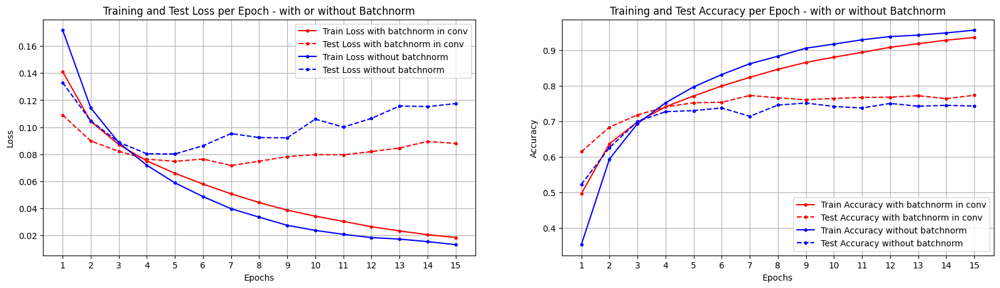

In [53]:
epochs = range(1, len(train_loss_norm) + 1)

# Create a 1x2 grid of subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

# Plot Losses on the first subplot
ax1.plot(epochs, train_loss_norm, 'r', marker='.', linestyle='-', label='Train Loss with batchnorm in conv')
ax1.plot(epochs, test_loss_norm, 'r', marker='.', linestyle='--', label='Test Loss with batchnorm in conv')
ax1.plot(epochs, train_loss, 'b', marker='.', linestyle='-', label='Train Loss without batchnorm')
ax1.plot(epochs, test_loss, 'b', marker='.', linestyle='--', label='Test Loss without batchnorm')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.set_title('Training and Test Loss per Epoch - with or without Batchnorm')
ax1.set_xticks(epochs)
ax1.grid()
ax1.legend()

# Plot Accuracies on the second subplot
ax2.plot(epochs, train_acc_norm, 'r', marker='.', linestyle='-', label='Train Accuracy with batchnorm in conv')
ax2.plot(epochs, test_acc_norm, 'r', marker='.', linestyle='--', label='Test Accuracy with batchnorm in conv')
ax2.plot(epochs, train_acc, 'b', marker='.', linestyle='-', label='Train Accuracy without batchnorm')
ax2.plot(epochs, test_acc, 'b', marker='.', linestyle='--', label='Test Accuracy without batchnorm')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.set_title('Training and Test Accuracy per Epoch - with or without Batchnorm')
ax2.set_xticks(epochs)
ax2.grid()
ax2.legend()

plt.show()

In [47]:
class Net_norm_fc(nn.Module):

    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(1024, 120)
        self.bn1 = nn.BatchNorm1d(120)
        self.fc2 = nn.Linear(120, 84)
        self.bn2 = nn.BatchNorm1d(84)
        self.fc3 = nn.Linear(84, 10)

    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x)))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = torch.flatten(x, 1)
        x = F.relu(self.bn1(self.fc1(x)))
        x = F.relu(self.bn2(self.fc2(x)))
        x = self.fc3(x)
        return x

net_norm_fc = Net_norm_fc()


In [48]:
criterion = nn.CrossEntropyLoss()
optimizer_norm_fc = optim.SGD(net_norm_fc.parameters(), lr=0.005, momentum=0.9)

In [49]:
n = 15
train_loss_norm_fc, test_loss_norm_fc, train_acc_norm_fc, test_acc_norm_fc= nepoch(n, trainloader, testloader, net_norm_fc, optimizer_norm_fc, criterion)

Epoch: 000 | Train Loss: 0.1535 |Test Loss: 0.1196 | Train accuracy: 0.4408 | Test accuracy: 0.5749
Epoch: 001 | Train Loss: 0.1164 |Test Loss: 0.09728 | Train accuracy: 0.5907 | Test accuracy: 0.6601
Epoch: 002 | Train Loss: 0.09738 |Test Loss: 0.09209 | Train accuracy: 0.6652 | Test accuracy: 0.6811
Epoch: 003 | Train Loss: 0.08488 |Test Loss: 0.07621 | Train accuracy: 0.7099 | Test accuracy: 0.7389
Epoch: 004 | Train Loss: 0.07512 |Test Loss: 0.07122 | Train accuracy: 0.745 | Test accuracy: 0.7574
Epoch: 005 | Train Loss: 0.06672 |Test Loss: 0.07413 | Train accuracy: 0.7732 | Test accuracy: 0.7497
Epoch: 006 | Train Loss: 0.05931 |Test Loss: 0.06838 | Train accuracy: 0.7987 | Test accuracy: 0.7663
Epoch: 007 | Train Loss: 0.05319 |Test Loss: 0.06731 | Train accuracy: 0.8184 | Test accuracy: 0.7691
Epoch: 008 | Train Loss: 0.04699 |Test Loss: 0.06562 | Train accuracy: 0.8413 | Test accuracy: 0.7797
Epoch: 009 | Train Loss: 0.04083 |Test Loss: 0.06843 | Train accuracy: 0.8608 | Test a

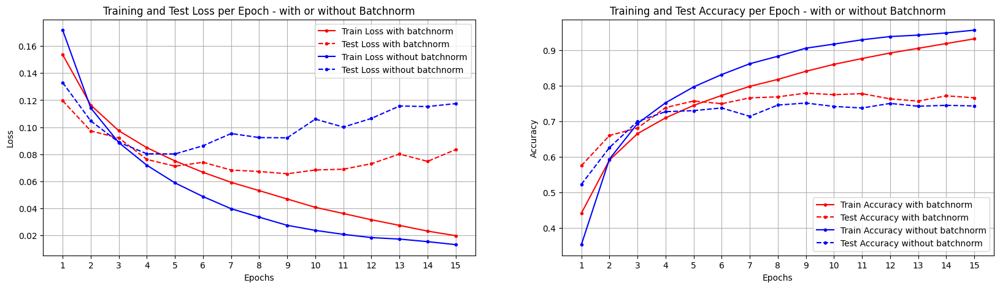

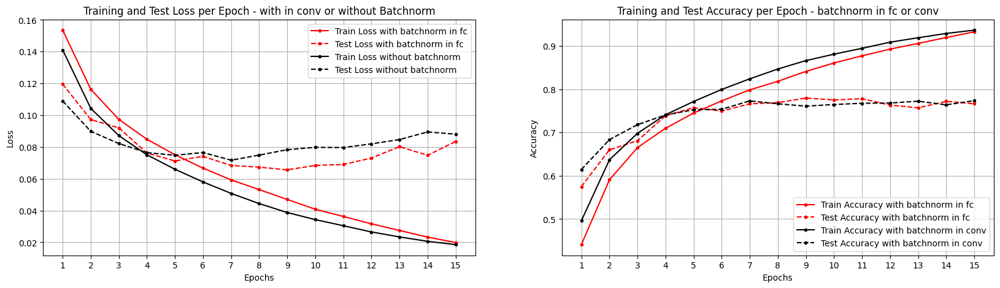

In [52]:
epochs = range(1, len(train_loss_norm_fc) + 1)

# Create a 1x2 grid of subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

# Plot Losses on the first subplot
ax1.plot(epochs, train_loss_norm_fc, 'r', marker='.', linestyle='-', label='Train Loss with batchnorm')
ax1.plot(epochs, test_loss_norm_fc, 'r', marker='.', linestyle='--', label='Test Loss with batchnorm')
ax1.plot(epochs, train_loss, 'b', marker='.', linestyle='-', label='Train Loss without batchnorm')
ax1.plot(epochs, test_loss, 'b', marker='.', linestyle='--', label='Test Loss without batchnorm')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.set_title('Training and Test Loss per Epoch - with or without Batchnorm')
ax1.set_xticks(epochs)
ax1.grid()
ax1.legend()

# Plot Accuracies on the second subplot
ax2.plot(epochs, train_acc_norm_fc, 'r', marker='.', linestyle='-', label='Train Accuracy with batchnorm')
ax2.plot(epochs, test_acc_norm_fc, 'r', marker='.', linestyle='--', label='Test Accuracy with batchnorm')
ax2.plot(epochs, train_acc, 'b', marker='.', linestyle='-', label='Train Accuracy without batchnorm')
ax2.plot(epochs, test_acc, 'b', marker='.', linestyle='--', label='Test Accuracy without batchnorm')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.set_title('Training and Test Accuracy per Epoch - with or without Batchnorm')
ax2.set_xticks(epochs)
ax2.grid()
ax2.legend()

plt.show()

epochs = range(1, len(train_loss_norm_fc) + 1)

# Create a 1x2 grid of subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5))

# Plot Losses on the first subplot
ax1.plot(epochs, train_loss_norm_fc, 'r', marker='.', linestyle='-', label='Train Loss with batchnorm in fc')
ax1.plot(epochs, test_loss_norm_fc, 'r', marker='.', linestyle='--', label='Test Loss with batchnorm in fc')
ax1.plot(epochs, train_loss_norm, 'black', marker='.', linestyle='-', label='Train Loss without batchnorm')
ax1.plot(epochs, test_loss_norm, 'black', marker='.', linestyle='--', label='Test Loss without batchnorm')
ax1.set_xlabel('Epochs')
ax1.set_ylabel('Loss')
ax1.set_title('Training and Test Loss per Epoch - with in conv or without Batchnorm')
ax1.set_xticks(epochs)
ax1.grid()
ax1.legend()

# Plot Accuracies on the second subplot
ax2.plot(epochs, train_acc_norm_fc, 'r', marker='.', linestyle='-', label='Train Accuracy with batchnorm in fc')
ax2.plot(epochs, test_acc_norm_fc, 'r', marker='.', linestyle='--', label='Test Accuracy with batchnorm in fc')
ax2.plot(epochs, train_acc_norm, 'black', marker='.', linestyle='-', label='Train Accuracy with batchnorm in conv')
ax2.plot(epochs, test_acc_norm, 'black', marker='.', linestyle='--', label='Test Accuracy with batchnorm in conv')
ax2.set_xlabel('Epochs')
ax2.set_ylabel('Accuracy')
ax2.set_title('Training and Test Accuracy per Epoch - batchnorm in fc or conv')
ax2.set_xticks(epochs)
ax2.grid()
ax2.legend()

plt.show()

### BatchNorm's performance in my Conv layers:
Improved generalization: The CNN model with BatchNorm demonstrates better generalization performance. As the number of epochs increases, the train loss of both models decreases, while the test loss starts increasing after 6 epochs, indicating overfitting. Compared to the Net model without BatchNorm, the model with BatchNorm exhibits a larger training loss and a smaller test loss. Additionally, it shows a lower training accuracy and a higher test accuracy. This means that the model with BatchNorm can adapt more effectively to various patterns and variations within the data, ultimately leading to improved performance on unseen test data.

Batch normalization contributes to the stabilization of the training process, resulting in enhanced generalization performance. By normalizing the inputs to each layer and maintaining consistent mean and variance values, it reduces internal covariate shift and mitigates the impact of vanishing or exploding gradients. These factors help the model learn more effectively from the training data and achieve better generalization on new, unseen data.

Improved training speed: By normalizing the inputs to each layer, BatchNorm effectively reduces the internal covariate shift. This leads to faster training as it allows for the use of higher learning rates and alleviates the vanishing gradient problem that can occur in deeper networks. The stabilization of input distributions across layers enables the model to converge more quickly, resulting in less time spent on training and improved overall efficiency.

Model with Batchnorm also prevents overfitting to some extent. Batchnorm addresses this issue by normalizing the input distribution to each layer, which makes it easier for the optimizer to learn the weights of the model. Additionally, batchnorm introduces some noise into the training process, which can also help prevent overfitting. By reducing the internal covariate shift and adding some noise, batchnorm can help to regularize the model and prevent overfitting to some extent.


### BatchNorm's performance in my Fc layers:

The main difference between using batch normalization in FC and Conv layers is the dimensionality of the input tensor and the corresponding batch normalization layer used.

In Fully Connected Layers (FC):

The input to the layer is a 1D tensor (a vector) for each sample in the batch.
The batch normalization layer used for fully connected layers is nn.BatchNorm1d(num_features), where num_features corresponds to the size of the input vector. It normalizes the input tensor along the batch dimension (dimension 0).
In Convolutional Layers (Conv):

The input to the layer is a 3D tensor (width x height x channels) for each sample in the batch.
The batch normalization layer used for convolutional layers is nn.BatchNorm2d(num_features), where num_features corresponds to the number of output channels in the convolutional layer. It normalizes the input tensor along the batch dimension (dimension 0) and spatial dimensions (dimensions 2 and 3).

We can find applying batch normalization in FC layers can also help in reducing overfitting, as it adds a slight regularization effect.

In [59]:
n=20
_,_,_,_ = nepoch(n, trainloader, testloader, net, optimizer, criterion, check=True)
_,_,_,_ = nepoch(n, trainloader, testloader, net_norm, optimizer_norm, criterion, check=True)
_,_,_,_ = nepoch(n, trainloader, testloader, net_norm_fc, optimizer_norm_fc, criterion, check=True)

Epoch: 000 | Train Loss: 0.04739 |Test Loss: 0.1578 | Train accuracy: 0.8827 | Test accuracy: 0.698
Epoch: 001 | Train Loss: 0.04502 |Test Loss: 0.2142 | Train accuracy: 0.8873 | Test accuracy: 0.6138
Epoch: 002 | Train Loss: 0.06828 |Test Loss: 0.1786 | Train accuracy: 0.8347 | Test accuracy: 0.701
Epoch: 003 | Train Loss: 0.07427 |Test Loss: 0.1554 | Train accuracy: 0.8166 | Test accuracy: 0.647
Epoch: 004 | Train Loss: 0.1134 |Test Loss: 0.1725 | Train accuracy: 0.6796 | Test accuracy: 0.5632
Epoch: 005 | Train Loss: 0.1215 |Test Loss: 0.1648 | Train accuracy: 0.6592 | Test accuracy: 0.5998
Epoch: 006 | Train Loss: 0.2032 |Test Loss: 0.2303 | Train accuracy: 0.2605 | Test accuracy: 0.1002
Epoch: 007 | Train Loss: 0.2304 |Test Loss: 0.2303 | Train accuracy: 0.09944 | Test accuracy: 0.0999
Epoch: 008 | Train Loss: 0.2304 |Test Loss: 0.2304 | Train accuracy: 0.1001 | Test accuracy: 0.1
model converges at 8th iteration
Epoch: 000 | Train Loss: 0.003174 |Test Loss: 0.1337 | Train accurac

I find the converge speed is faster after batchnorm. Batch normalization is a technique that standardizes the inputs to a layer in the network by normalizing the activations across a mini-batch. This helps to mitigate the internal covariate shift, which is the change in the distribution of the layer inputs during training. As a result, it allows the network to be trained faster and achieve better accuracy with fewer training iterations.

# Part 2: The DeepDream method

## Task1:

In [2]:
import urllib.request
# sample execution (requires torchvision)
from PIL import Image
from torchvision import transforms
import numpy as np
import torch
import torch.nn as nn
import torchvision
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn.functional as F
from torchvision.transforms.functional import to_pil_image

url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg","dog.jpg")
try: 
  urllib.URLopener().retrieve(url, filename)
except:
  urllib.request.urlretrieve(url, filename)

input_image = Image.open(filename)
preprocess = transforms.Compose([
transforms.Resize(299),
transforms.CenterCrop(299),
transforms.ToTensor(),
transforms.Normalize(mean=[0.485, 0.456, 0.406],
std=[0.229, 0.224, 0.225]),
])
input_tensor = preprocess(input_image)
input_batch = input_tensor.unsqueeze(0) # create a minibatch as expected by the model

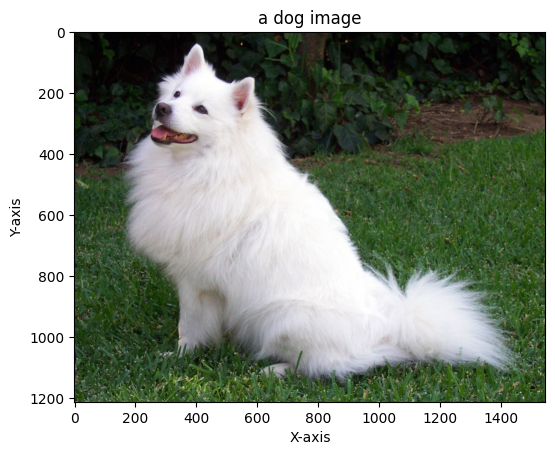

In [3]:
# Print initial image
plt.imshow(input_image)
plt.title('a dog image')
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.show()

## Task 2: Load the pre-trained model and write code to allow for a ’hook’

1. This code loads a pre-trained Inception V3 model from the PyTorch model hub, by specifying _pretrained=True_, the model is loaded with pre-trained weights from the ImageNet dataset. 

2. Then the code sets the model to evaluation mode using model.eval(). This is important because it disables some layers' specific behaviors, such as dropout and batch normalization, which are used during training but not during inference.

3. An empty list called outputs is created to store the output of the model at a specific layer. 

4. Followed by a hook function: hook(module, input, output), which is used to access the intermediate values within a deep learning model during its forward or backward pass. In this case, the hook function hook is designed to capture the output of a specific layer in the model during the forward pass.
Inside the hook function, the output of the layer is appended to the outputs list. This allows you to examine or manipulate the intermediate values of the model, which can be helpful for debugging, visualization, or implementing custom behavior during training or inference.


In [4]:
model = torch.hub.load('pytorch/vision:v0.10.0', 'inception_v3', pretrained=True)
model.eval()

Using cache found in C:\Users\a1892/.cache\torch\hub\pytorch_vision_v0.10.0
e:\Python\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
e:\Python\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

In [5]:
outputs= [] # Create an empty list called outputs.
def hook(module, input, output):

    # module: The CNN layer (module) for which the hook is executed.
    # input: A tuple containing the input tensors to the module.
    # output: The output tensor(s) produced by the module.
    
    outputs.append(output)  # keep track of the outputs of the layers to which the hook is attached

Hooks in PyTorch are callback functions that can be attached to a specific layer (module) in the neural network, and they are executed either during the forward pass or the backward pass of the network. And this hook is designed to be executed during the forward pass of the network.

## Task3: Create a hook

In [6]:
# register a forward hook for layer Inception3
h = model.Mixed_5b.register_forward_hook(hook)

During the forward pass of the network, the hook function will be called with the input and output tensors of the Mixed_5b layer. As you defined earlier, the hook function appends the output tensor to the outputs list.

## Task4:

In [7]:
def tensor_to_image(input_batch):
    # Define the transform to undo the normalization
    rescale = transforms.Compose([
        transforms.Normalize(mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225], 
                             std=[1/0.229, 1/0.224, 1/0.225]),
    ])

    # Squeeze the image tensor and apply the transform
    image = input_batch.squeeze()
    image = rescale(image)

    # Move the channels to the last dimension and scale to [0, 1]
    image = image.permute(1, 2, 0)
    image = (image - image.min()) / (image.max() - image.min())

    # Convert the tensor to a numpy array and return it
    return image.detach().numpy()


### Define a function that performs gradient ascent on an input image to maximize the L2 norm of the output of a given layer

In [8]:
def gradient_as(n_iter, lr, input_image, target_layer):
    
    '''
    n_iter: an integer representing the number of iterations for the optimization process.
    lr: a float representing the learning rate for the optimizer.
    input_image: a image representing the input image to be optimized.
    target_layer: a PyTorch layer representing the layer to optimize the input image for.
    Returns:
    optim_image: a numpy array representing the optimized version of the input image.
    '''
    
    # Define the pre-processing transform for the input image
    preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]),
    ])
    # Apply the pre-processing transform to the input image
    input_tensor = preprocess(input_image)
    input_batch = input_tensor.unsqueeze(0) # create a minibatch as expected by the model
    # Clone the input batch to initialize the output image
    image0 = torch.clone(input_batch)
    # Define the hook to get the output of the target layer
    outputs = []
    def hook(module, input, output): # Define a hook function to register with the target layer
        outputs.append(output) 

    # Define the optimizer to update the input image using gradient ascent
    image0.requires_grad_()
    # Register the hook on the target layer
    hook_handle = target_layer.register_forward_hook(hook)

    for i in range(n_iter):

        # Clear the outputs list
        outputs.clear()

        # Forward pass
        output = model(image0)

        # Get the output of the target layer
        target_output = outputs[-1]

        # Compute the loss based on the L2 norm of the output
        loss = torch.norm(target_output, p=2)

        # Backward pass to compute the gradients of the input image
        loss.backward()

        # Compute the gradients of the L2 norm loss
        g = image0.grad

        # Scale the gradients by their absolute average
        scale_factor = torch.abs(g).mean()
        g /= scale_factor

        # Update the input image by gradient ascent
        image0.data += lr * g


        # zero the gradient
        image0.grad.zero_()

        # Print the progress
        if i % 100 == 0:
            print(f"Iteration {i}/{n_iter}, loss: {loss.item()}")

    # Remove the forward hook when done
    hook_handle.remove()
    # Convert the final optimized tensor image to a numpy array
    optim_image = tensor_to_image(image0)
    return optim_image

In [14]:
# Define the target layers to optimize for
target_layer = model.Mixed_5b
optim_batch = gradient_as(n_iter=300, lr=0.005, input_image = input_image, target_layer=target_layer)

Iteration 0/300, loss: 677.9002075195312
Iteration 100/300, loss: 1096.2998046875
Iteration 200/300, loss: 1318.38916015625


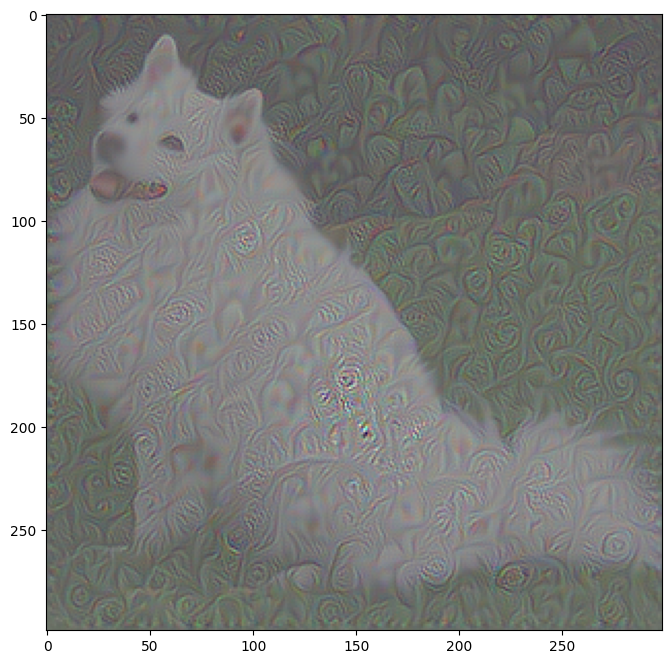

In [15]:
plt.figure(figsize=(10,8))
plt.imshow(optim_batch)

## Task5:

In [17]:
# Generate the images for different choices of layer activations
layer_names = ['Conv2d_3b_1x1','Mixed_5b', 'Mixed_5c', 'Mixed_6a', 'Mixed_7a']
# Generate the images for different choices of number of optimisation steps
n_iter = [10, 50, 100, 200, 500]
im_list = [[],[],[],[],[]]
for i in range(len(layer_names)):
    for n in n_iter:
        # Set the target layer to optimize for
        target_layer = getattr(model, layer_names[i])
        opti_im = gradient_as(n_iter=n, lr=0.005, input_image = input_image, target_layer=target_layer)
        im_list[i].append(opti_im)

Iteration 0/10, loss: 494.2883605957031
Iteration 0/50, loss: 494.2883605957031
Iteration 0/100, loss: 494.2883605957031
Iteration 0/200, loss: 494.2883605957031
Iteration 100/200, loss: 958.7252807617188
Iteration 0/500, loss: 494.2883605957031
Iteration 100/500, loss: 958.7252807617188
Iteration 200/500, loss: 1317.1219482421875
Iteration 300/500, loss: 1656.3936767578125
Iteration 400/500, loss: 2026.657470703125
Iteration 0/10, loss: 677.9002075195312
Iteration 0/50, loss: 677.9002075195312
Iteration 0/100, loss: 677.9002075195312
Iteration 0/200, loss: 677.9002075195312
Iteration 100/200, loss: 1096.2998046875
Iteration 0/500, loss: 677.9002075195312
Iteration 100/500, loss: 1096.2998046875
Iteration 200/500, loss: 1318.38916015625
Iteration 300/500, loss: 1556.8953857421875
Iteration 400/500, loss: 1936.8143310546875
Iteration 0/10, loss: 561.5008544921875
Iteration 0/50, loss: 561.5008544921875
Iteration 0/100, loss: 561.5008544921875
Iteration 0/200, loss: 561.5008544921875
Ite

In [21]:
def plot_layers(im_list, layer_names, n_iter, figsize=(15, 25)):
    num_layers = len(layer_names)
    num_iterations = len(n_iter)

    # Create a grid of subplots to display the images
    fig, ax = plt.subplots(num_iterations, num_layers, figsize=figsize)

    for i in range(num_layers):
        for n in range(num_iterations):
            ax[n, i].imshow(im_list[i][n])
            ax[n, i].set_title(f"{layer_names[i]} optimization after {n_iter[n]} iterations")

    # Set x-axis and y-axis labels
    for i in range(num_layers):
        ax[-1, i].set_xlabel("X pixel scaling")
    for n in range(num_iterations):
        ax[n, 0].set_ylabel("Y pixel scaling")

    plt.tight_layout()
    plt.show()

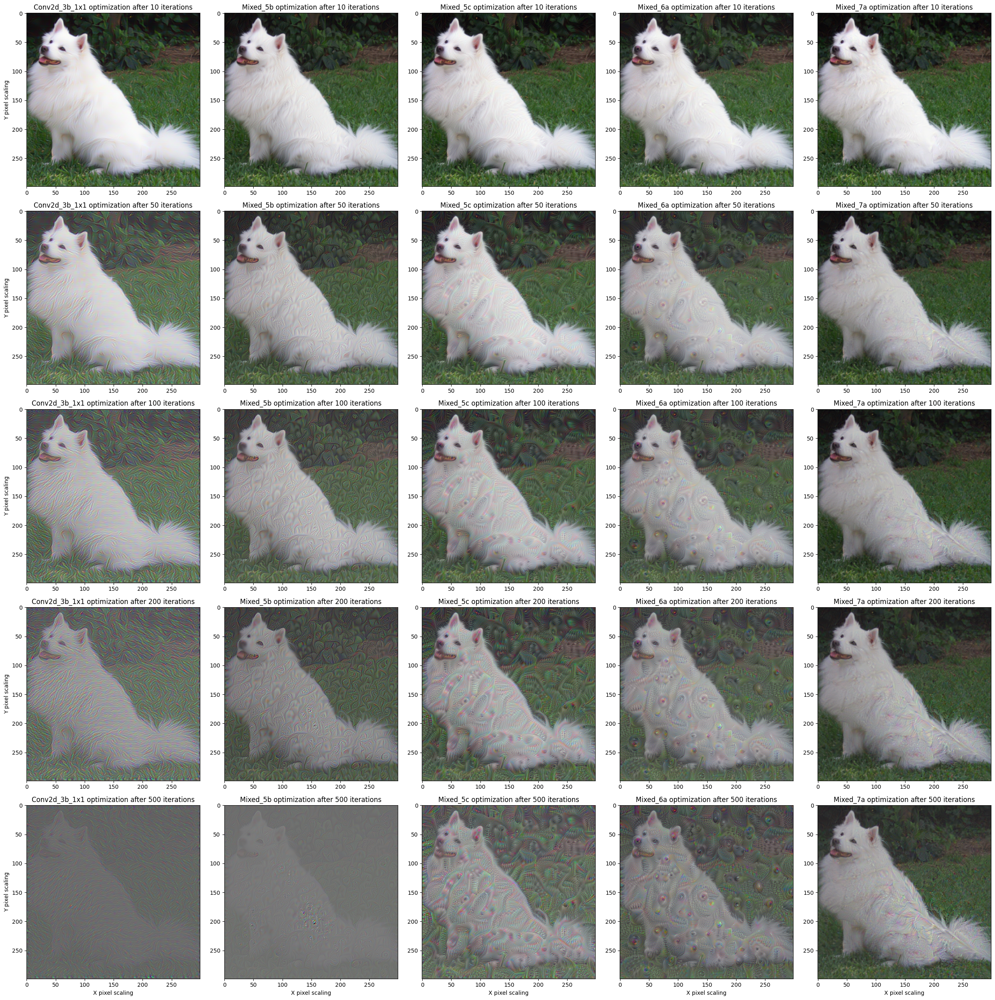

In [23]:
plot_layers(im_list, layer_names, n_iter, figsize=(25, 25))

Deepdream can enhance the features and patterns present in the input image, which may result in surreal and dreamlike images. And my explanation on the 'dream' effect on the input dog image:

From these plots, we find using different layers in Inception_v3 for DeepDream has a significant impact on the output image. For example,in the Conv2d_3b_1x1, this early convolutional layer has a 1x1 kernel, using it with DeepDream, detects basic features like edges, lines; in the Mixed_5b, Mixed_5c layers, these mixed layers are in the middle portion of the network and capture moderately complex features, the dog's fur, face and other features may appear enhanced; in the Mixed_6a layer, positioned deeper in the network, this mixed layer capture more complex features and larger structures, when used with DeepDream, the generated images will have more detailed patterns, shapes, and abstract object representations, the dog's features may become more stylized, and some recognizable objects may start to emerge in the background or surrounding areas, the dog's overall structure may begin to blend with these new elements;  the deepdream captures the dog's face feature; in the Mixed_6e layer, the deepdream captures the dog's eye feature; in the Mixed_7a layer, even deeper in the network, this mixed layer focuses on more complex features and entire objects or scenes, the dog transforms into a combination of different objects or scenes, creating a surreal and visually striking image. 

We summarize optimizing for the lower layers can result in images with more abstract and repetitive patterns, while optimizing for higher layers can produce images with more recognizable objects or textures.

The number of optimization steps determines how many times the optimization algorithm will adjust the input image to maximize the activation of the target layer. ncreasing the number of iterations can result in more complex and detailed features being generated in the optimized image, as the algorithm has more time to adjust the image to maximize the target layer's activation. However, there is a trade-off between the number of iterations and the time it takes to generate the optimized image. Too few iterations may result in underdeveloped features, while too many iterations may lead to overfitting or the generation of meaningless features. For example, if iterations are 10, we can not observe what features are generated. If iterations are 1000, the generation of too many leaves make the image not clear, which lead to the generation of high-frequency noise that can obscure the details of the image. 

## Task6:

In [9]:
def gradient_as_multi(n_iter, lr, input_image, target_layers):

    preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]),
    ])
    input_tensor = preprocess(input_image)
    image0 = input_tensor.unsqueeze(0) # create a minibatch as expected by the model

    # Define the hooks to get the output of the target layers
    outputs = []
    hooks = []
    def hook(module, input, output):
        outputs.append(output)
    for layer in target_layers:
        hooks.append(layer.register_forward_hook(hook))

    # Define the optimizer
    image0.requires_grad_()

    for i in range(n_iter):

        # Clear the outputs list
        outputs.clear()

        # Forward pass
        output = model(image0)
        # Compute the losses based on the L2 norm of the output for each target layer
        total_loss = 0
        for layer_output in outputs:
            
            layer_loss =torch.norm(layer_output, p=2)
            total_loss += layer_loss

        # Backward pass to compute the gradients of the input image
        total_loss.backward(retain_graph=True)
        
        # Compute the gradients of the L2 norm loss
        g = image0.grad

        # Scale the gradients by their absolute average
        if g is not None:
            scale_factor = torch.abs(g).mean()
            g /= scale_factor


        # Update the input image by gradient ascent
        image0.data += lr * g

        # zero the gradient
        image0.grad.zero_()

        # Print the progress
        if i % 100 == 0:
            print(f"Iteration {i}/{n_iter}, loss: {total_loss.item()}")
            optim_image = tensor_to_image(image0)
            plt.figure()
            plt.imshow(optim_image)
            plt.title(f"multilayer image")
            plt.axis("off")
            plt.show()

    # Remove the hooks from the target layers
    for hook in hooks:
        hook.remove()
    optim_image = tensor_to_image(image0)
    return optim_image


Iteration 0/300, loss: 2233.023193359375


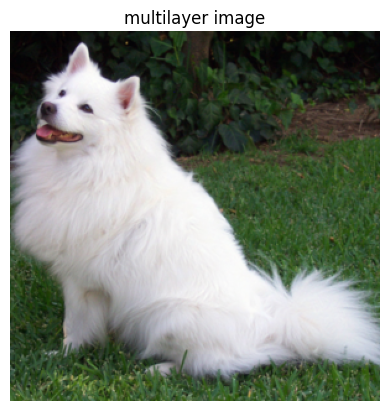

Iteration 100/300, loss: 3992.506103515625


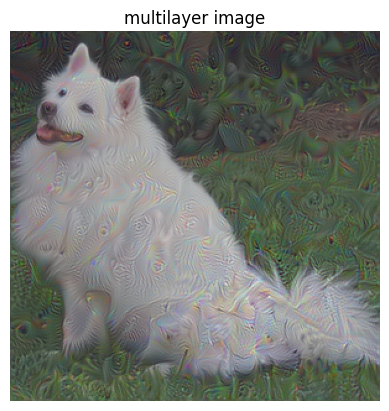

Iteration 200/300, loss: 4654.7705078125


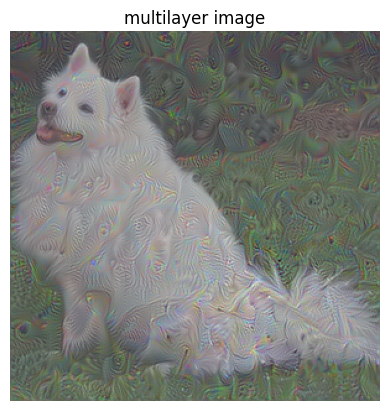

In [25]:
# Define the target layers to optimize for
target_layers = [model.Conv2d_3b_1x1, model.Mixed_5b, model.Mixed_5c, model.Mixed_6a, model.Mixed_7a]

multi_image = gradient_as_multi(n_iter=300, lr=0.01, input_image= input_image, target_layers=target_layers)

After optimizing for multiple layers, we can observe how the features generated in each layer contribute to the final image, resulting in a more intricate and varied final image. We can find the background leaves, dog faces, dog eyes, fur and so on in the picture.

## Task7:

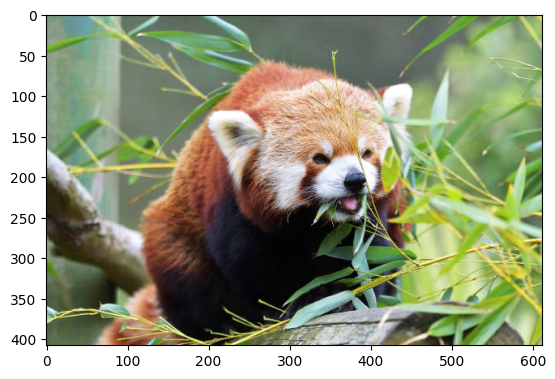

In [10]:
url, filename = ("https://raw.githubusercontent.com/YZ10619/image-for-ml-cw/main/istockphoto-1098270084-612x612.jpg?token=GHSAT0AAAAAACAU7O43QWSFUTMKHLS5X74KZBEPBJA","IMG_9210-scaled-1200x900-cropped.jpg")
try: 
  urllib.URLopener().retrieve(url, filename)
except:
  urllib.request.urlretrieve(url, filename)

input_image2 = Image.open(filename)

# Display the image
plt.imshow(input_image2)

In [11]:
target_layers = [model.Conv2d_1a_3x3, model.Conv2d_3b_1x1, model.Mixed_5b, model.Mixed_5c, model.Mixed_5d, model.Mixed_6a, model.Mixed_6b, model.Mixed_6c, model.Mixed_6d, model.Mixed_6e, model.Mixed_7a, model.Mixed_7b]
im_list = []
n_iter=200
for i in target_layers:
    im = gradient_as(n_iter, lr=0.01, input_image = input_image2, target_layer=i)
    im_list.append(im)

Iteration 0/200, loss: 1218.114501953125
Iteration 100/200, loss: 1652.4732666015625
Iteration 0/200, loss: 546.1904296875
Iteration 100/200, loss: 1301.0064697265625
Iteration 0/200, loss: 709.2476806640625
Iteration 100/200, loss: 1299.16162109375
Iteration 0/200, loss: 610.796630859375
Iteration 100/200, loss: 1147.4521484375
Iteration 0/200, loss: 430.32806396484375
Iteration 100/200, loss: 920.502685546875
Iteration 0/200, loss: 422.75164794921875
Iteration 100/200, loss: 1086.357421875
Iteration 0/200, loss: 255.99671936035156
Iteration 100/200, loss: 808.1508178710938
Iteration 0/200, loss: 260.389892578125
Iteration 100/200, loss: 897.9805908203125
Iteration 0/200, loss: 215.89077758789062
Iteration 100/200, loss: 1131.690185546875
Iteration 0/200, loss: 114.63860321044922
Iteration 100/200, loss: 419.5699768066406
Iteration 0/200, loss: 131.5453338623047
Iteration 100/200, loss: 677.2023315429688
Iteration 0/200, loss: 71.32587432861328
Iteration 100/200, loss: 623.71643066406

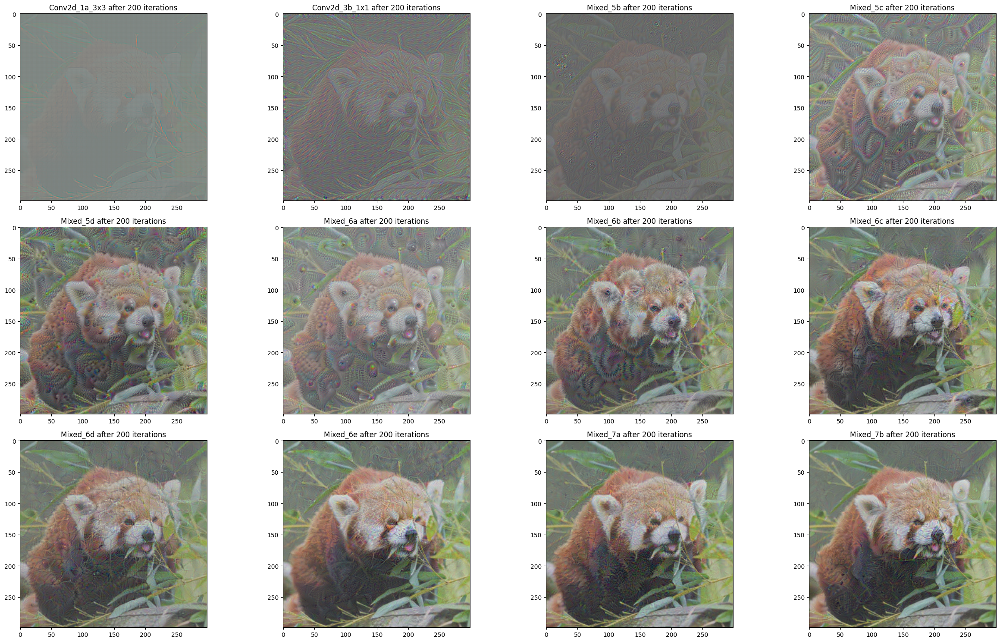

In [19]:
name_layers = ['Conv2d_1a_3x3', 'Conv2d_3b_1x1', 'Mixed_5b', 'Mixed_5c', 'Mixed_5d','Mixed_6a', 'Mixed_6b', 'Mixed_6c', 'Mixed_6d', 'Mixed_6e', 'Mixed_7a','Mixed_7b']

fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(25, 15))

for i in range(12):
    row = i // 4
    col = i % 4
    ax = axes[row, col]
    ax.imshow(im_list[i])
    ax.set_title(f'{name_layers[i]} after 200 iterations')

plt.tight_layout()
plt.show()


The lower layers of the neural network accentuate fundamental features of the raccoon, such as the edges of its body, fur texture, and other surface details. In contrast, the middle layers capture more intricate aspects, including the patterns of its facial markings, shapes of its limbs and tail, and various components of its body structure. The higher layers, however, concentrate on the raccoon's overall form, interaction with larger objects in the scene, and the arrangement of the entire composition, including the raccoon and its surrounding environment.

Iteration 0/200, loss: 2689.5107421875


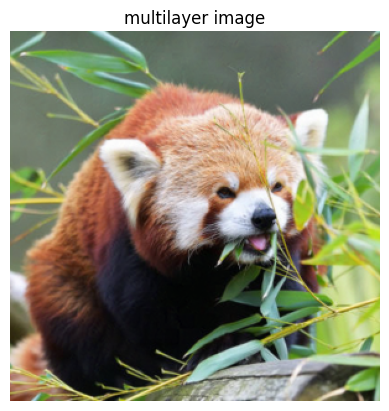

Iteration 100/200, loss: 5296.39501953125


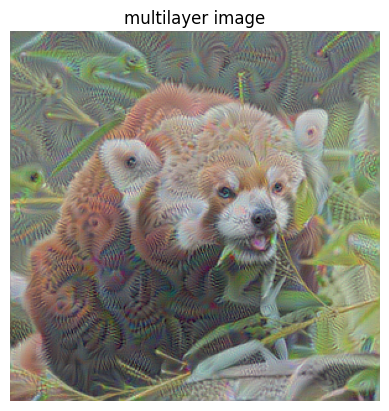

In [21]:
# Define the target layers to optimize for
target_layers3 = [model.Mixed_5b, model.Mixed_5c, model.Mixed_5d, model.Mixed_6a, model.Mixed_6b, model.Mixed_6c]
optim_multi_1 = gradient_as_multi(200, 0.01, input_image2, target_layers3)

Text(0.5, 1.0, 'final image after multilayer optimization')

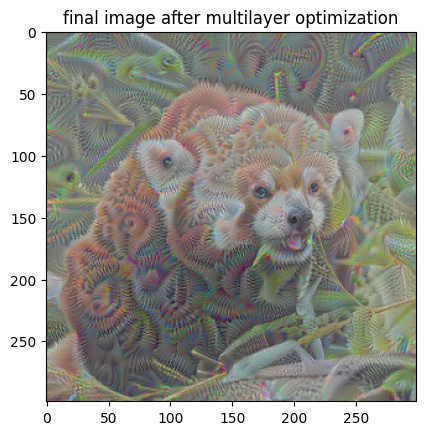

In [22]:
plt.imshow(optim_multi_1)
plt.title('final image after multilayer optimization')

In this multilayer image, we can observe that the features of the raccoon and the background, captured separately by the six individual layers, have been combined to create a comprehensive and detailed representation.

### octave method 

Applying the octave method for DeepDream on an image of raccoons involves processing the image at different scales to generate a final output with a wide range of details. This approach can help enhance the appearance of the raccoons and their surroundings, revealing intricate patterns, textures, and structures. Here's how you can apply the octave method to a raccoon image:

Create an image pyramid: Resize the raccoon image to multiple scales (octaves), typically starting with a smaller size and progressively increasing. This generates a series of images with varying resolutions.

Process each octave: Apply the DeepDream algorithm to each image in the pyramid, starting from the smallest image and working your way up to the original size. For each octave, select a layer of the neural network to optimize and enhance the features and patterns in the image. This step will emphasize various aspects of the raccoons and their environment, such as fur texture, facial markings, and background elements.

Blend the results: After processing all the octaves, combine the resulting images (usually by adding the upscaled smaller images to the next larger image in the sequence) to create a final output image that incorporates the details and patterns generated at each scale.


C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:33: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image = image.resize((int(image.width * octave_scale), int(image.height * octave_scale)), Image.ANTIALIAS)


Processing octave 1/3


C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:67: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  output_image = output_image.resize((next_octave.width, next_octave.height), Image.ANTIALIAS)


Processing octave 2/3
Processing octave 3/3


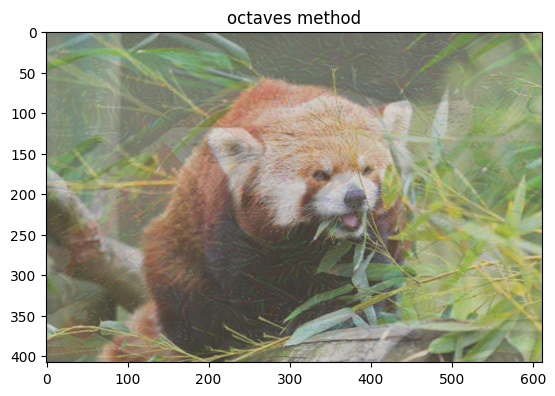

In [24]:
import urllib.request
# sample execution (requires torchvision)
from PIL import Image
from torchvision import transforms
import numpy as np
import torch
import torch.nn as nn
import torchvision
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn.functional as F


target_layer = model.Mixed_6a

def deep_dream_octaves(input_image, model, n_iter, lr, num_octaves, octave_scale):
    preprocess = transforms.Compose([
        transforms.Resize(299),
        transforms.CenterCrop(299),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406],
                             std=[0.229, 0.224, 0.225]),
    ])

    postprocess = transforms.Compose([
        transforms.Normalize(mean=[-0.485/0.229, -0.456/0.224, -0.406/0.225], std=[1/0.229, 1/0.224, 1/0.225]),
        transforms.ToPILImage()
    ])

    image = Image.open(input_image)
    octaves = [image]
    for _ in range(num_octaves - 1):
        image = image.resize((int(image.width * octave_scale), int(image.height * octave_scale)), Image.ANTIALIAS)
        octaves.append(image)

    # Define the hook to get the output of the target layer
    outputs = []

    def hook(module, input, output):
        outputs.append(output)

    # Register the hook on the target layer
    hook_handle = target_layer.register_forward_hook(hook)

    for octave_idx, octave in enumerate(octaves[::-1]):
        print(f"Processing octave {octave_idx + 1}/{num_octaves}")
        input_tensor = preprocess(octave).unsqueeze(0)
        input_tensor.requires_grad_()
        for i in range(n_iter):
            model.zero_grad()
            output = model(input_tensor)
            target_output = output
            loss = torch.norm(target_output, p=2)
            loss.backward()
            g = input_tensor.grad
            if g is not None:
                scale_factor = torch.abs(g).mean()
                g /= scale_factor
            input_tensor.data += lr * g
            input_tensor.data.clamp_(0, 1)
            input_tensor.grad.zero_()
          
        output_tensor = input_tensor.detach()
        output_image = postprocess(output_tensor.squeeze(0))
        if octave_idx < num_octaves - 1:
            next_octave = octaves[-octave_idx - 2]
            output_image = output_image.resize((next_octave.width, next_octave.height), Image.ANTIALIAS)
            octaves[-octave_idx - 2] = Image.blend(next_octave, output_image, 0.5)

    # Remove the forward hook when done
    hook_handle.remove()

    final_image = octaves[0]
    final_image.save("deep_dream_octaves_output.jpg")
    plt.imshow(final_image)
    plt.title('octaves method')

# Parameters for Deep Dream with octaves

iterations = 300
lr = 0.01
num_octaves = 3
octave_scale = 1.4

# Run Deep Dream with octaves
deep_dream_octaves(filename, model, iterations, lr, num_octaves, octave_scale)


Using a larger scale, the resulting image will have a smaller size after each octave. This means that features of larger scales will become more prominent in the image, but details of smaller scales may be lost.

C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:33: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image = image.resize((int(image.width * octave_scale), int(image.height * octave_scale)), Image.ANTIALIAS)


Processing octave 1/3


C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:67: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  output_image = output_image.resize((next_octave.width, next_octave.height), Image.ANTIALIAS)


Processing octave 2/3
Processing octave 3/3


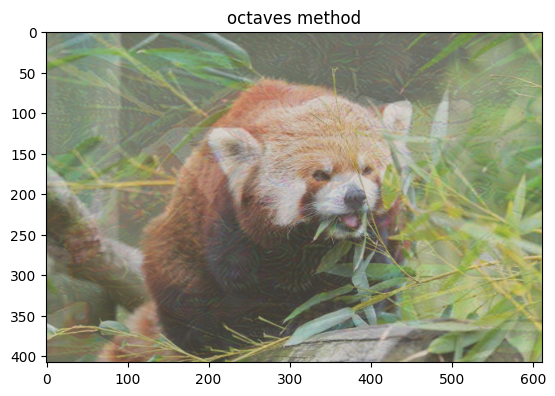

In [25]:
# Parameters for Deep Dream with octaves

iterations = 300
lr = 0.01
num_octaves = 3
octave_scale = 2

# Run Deep Dream with octaves
deep_dream_octaves(filename, model, iterations, lr, num_octaves, octave_scale)

Using a larger number of iterations, the optimization process will continue for more steps, potentially resulting in more detailed and intricate visual patterns.

C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:33: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image = image.resize((int(image.width * octave_scale), int(image.height * octave_scale)), Image.ANTIALIAS)


Processing octave 1/3


C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:67: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  output_image = output_image.resize((next_octave.width, next_octave.height), Image.ANTIALIAS)


Processing octave 2/3
Processing octave 3/3


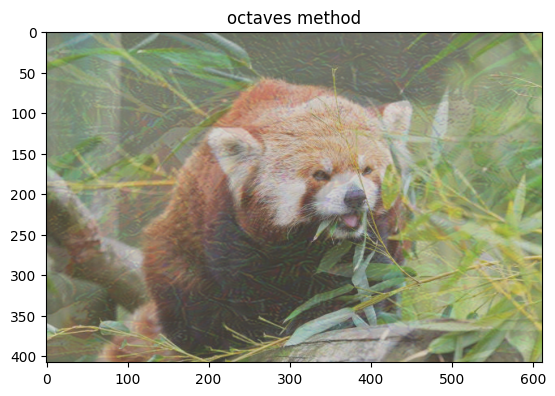

In [26]:
# Parameters for Deep Dream with octaves
iterations = 500
lr = 0.01
num_octaves = 3
octave_scale = 1.4

# Run Deep Dream with octaves
deep_dream_octaves(filename, model, iterations, lr, num_octaves, octave_scale)

If you use a larger number of octaves, the image will be downsampled and processed through more levels of the deep dream algorithm. This can result in more complex and intricate patterns, as well as more refined details, but it can also increase the processing time and require more memory.

C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:33: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  image = image.resize((int(image.width * octave_scale), int(image.height * octave_scale)), Image.ANTIALIAS)


Processing octave 1/6


C:\Users\a1892\AppData\Local\Temp\ipykernel_15628\1394618228.py:67: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  output_image = output_image.resize((next_octave.width, next_octave.height), Image.ANTIALIAS)


Processing octave 2/6
Processing octave 3/6
Processing octave 4/6
Processing octave 5/6
Processing octave 6/6


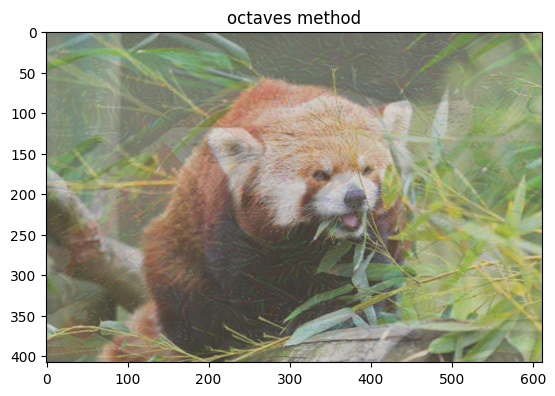

In [27]:
# Parameters for Deep Dream with octaves
iterations = 300
lr = 0.01
num_octaves = 6
octave_scale = 1.4

# Run Deep Dream with octaves
deep_dream_octaves(filename, model, iterations, lr, num_octaves, octave_scale)

The octaves method is a technique used in DeepDream to generate high-resolution images by iteratively scaling up and processing the image at different scales.

The basic idea is to start with a low-resolution version of the input image and optimize it for a certain number of iterations at that scale. Then, the image is scaled up to a higher resolution (by a factor of 2 or more) and the optimization process is repeated at the new scale. This is repeated for several scales, with each scale being called an octave.

By processing the image at different scales, the octaves method allows for the generation of high-resolution images that retain the details and features of the original image while also introducing new patterns and textures at different scales. The lower-resolution versions of the image allow for the optimization process to capture more global features and structure, while the higher-resolution versions allow for the optimization process to capture more fine-grained details and textures.

In summary, the octave method allows DeepDream to generate a richer and more diverse visual output for the raccoon image, capturing both fine details from smaller scales and more prominent features from larger scales. This results in an image that exhibits a broad range of patterns, textures, and structures, enhancing the overall visual appeal and artistic effect of the raccoons in the DeepDream-generated image.